In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [2]:
# Find the camera matrix

def camera_calibration(nx, ny):
    img = []
    obj = []
    objp = np.zeros((nx*ny,3),np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
    for i in range(1,21):
        filename = 'C://self-driving//CarND-Advanced-Lane-Lines-master//camera_cal//calibration' + str(i) + '.jpg'
        image = mpimg.imread(filename)
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        if ret == True:
            img.append(corners)
            obj.append(objp)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj, img, gray.shape[::-1], None, None)
    return ret, mtx, dist, rvecs, tvecs

ret, mtx, dist, rvecs, tvecs = camera_calibration(9,6)

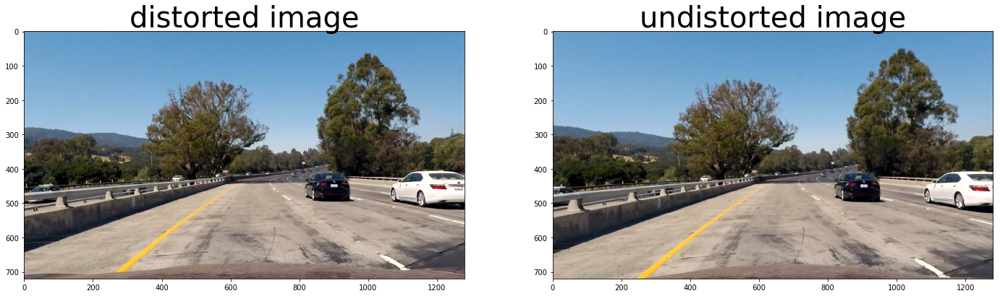

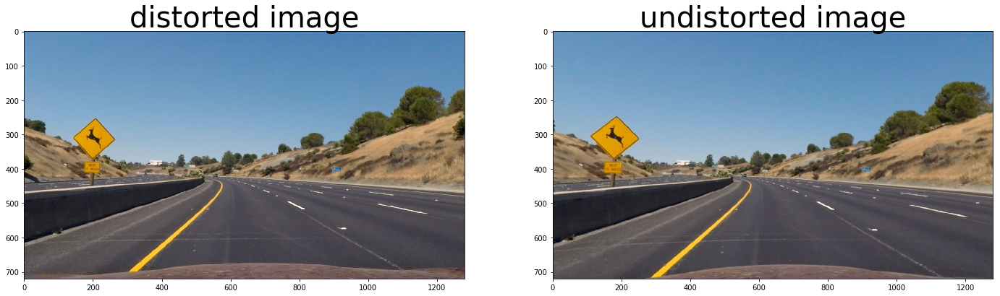

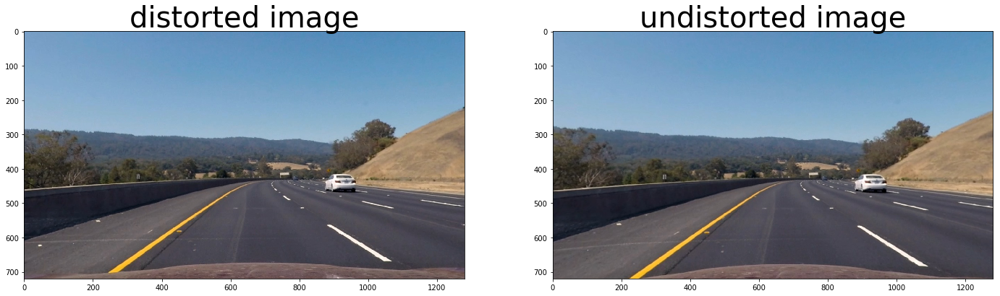

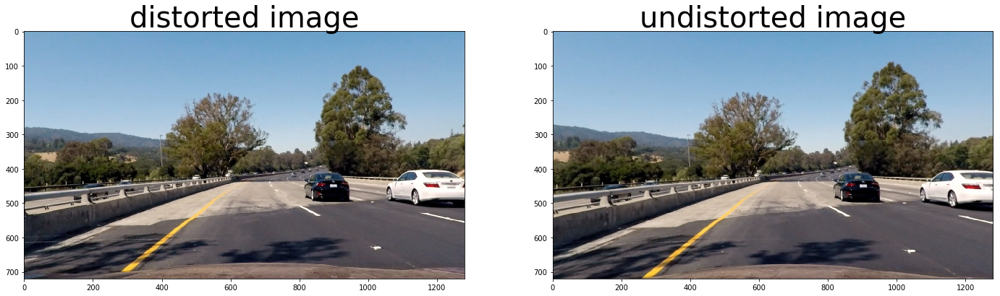

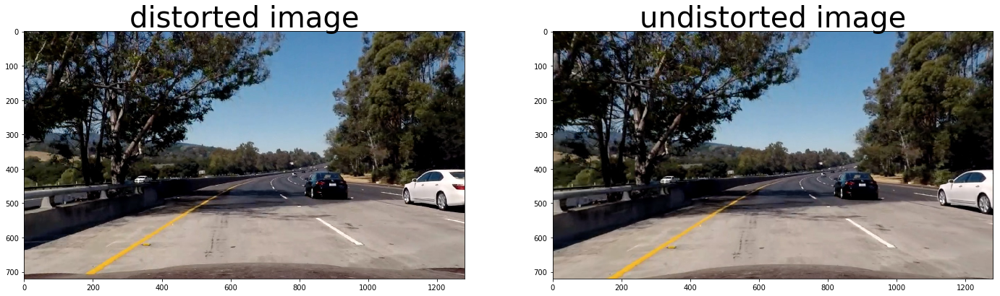

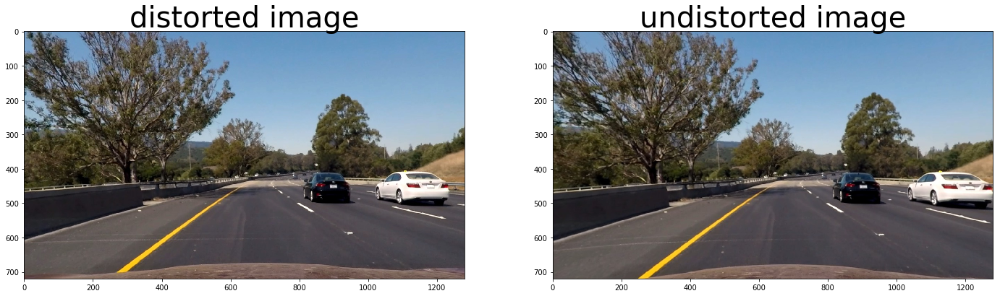

In [3]:
# Results of camera calibration

def undistort(img, mtx, dist):
    undistorted_image = cv2.undistort(img, mtx, dist, None, mtx)
    
    return undistorted_image

test_images = []
for i in range(1,7):
    images = mpimg.imread('C://self-driving//CarND-Advanced-Lane-Lines-master//test_images//test' + str(i) + '.jpg')
    images = undistort(images, mtx, dist)
    test_images.append(images)
    
for test_image in test_images:
    undistort_image = undistort(test_image, mtx, dist)
    f, (ax1, ax2) = plt.subplots(1,2, figsize = (24,9))
    ax1.imshow(test_image)
    ax1.set_title("distorted image", fontsize = 40)
    ax2.imshow(undistort_image)
    ax2.set_title("undistorted image", fontsize = 40)
    plt.show()

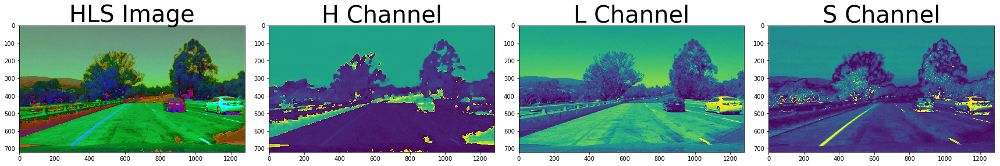

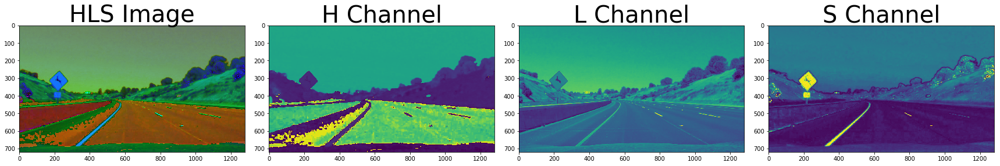

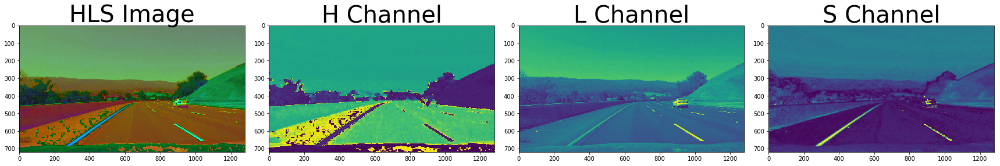

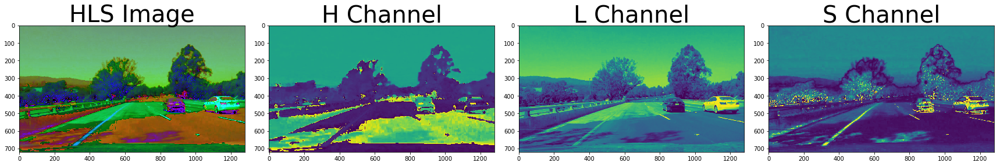

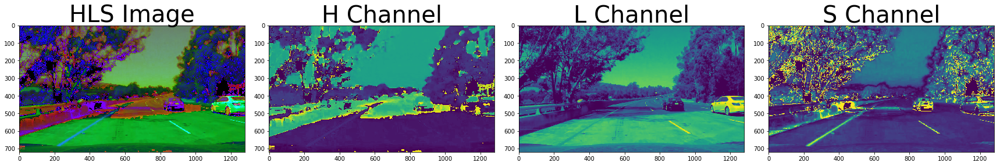

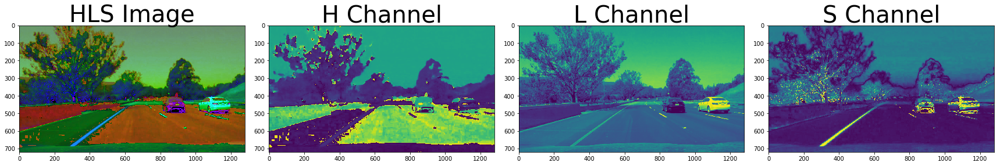

In [4]:
# HLS threshold test

for i in range(1,7):
    filename = 'C://self-driving//CarND-Advanced-Lane-Lines-master//test_images//test' + str(i) + '.jpg'
    img = mpimg.imread(filename)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(hls)
    ax1.set_title('HLS Image', fontsize=40)
    ax2.imshow(H)
    ax2.set_title('H Channel', fontsize=40)
    ax3.imshow(L)
    ax3.set_title('L Channel', fontsize=40)
    ax4.imshow(S)
    ax4.set_title('S Channel', fontsize=40)
    plt.show()

In [5]:
# It is obvious that S Channel capture the lanes best.
# S threshold

def S_threshold(img, thresh = (20,100)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    S = hls[:,:,2]
    sobelx = cv2.Sobel(S, cv2.CV_64F, 1, 0)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sxbinary

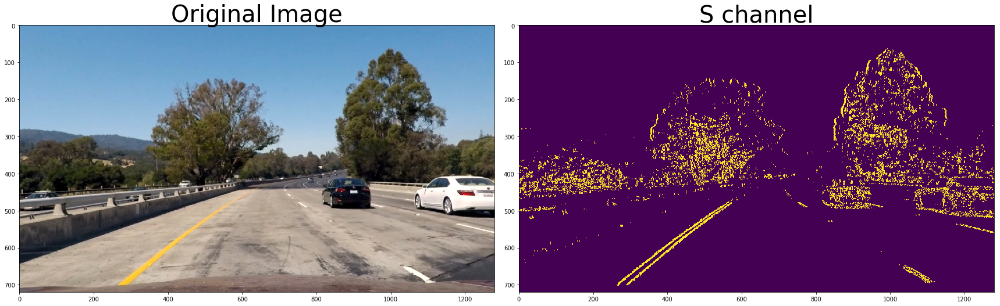

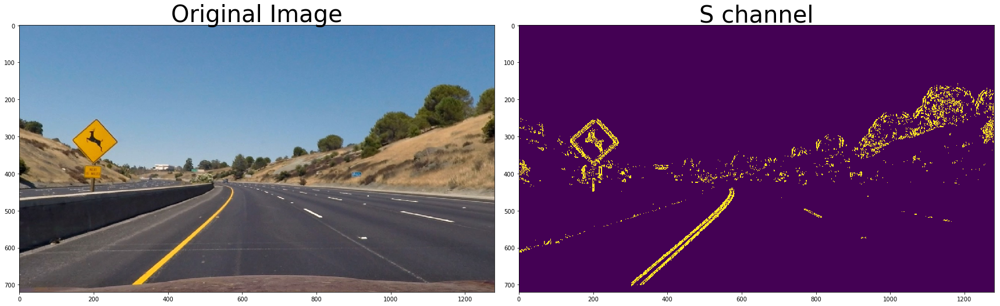

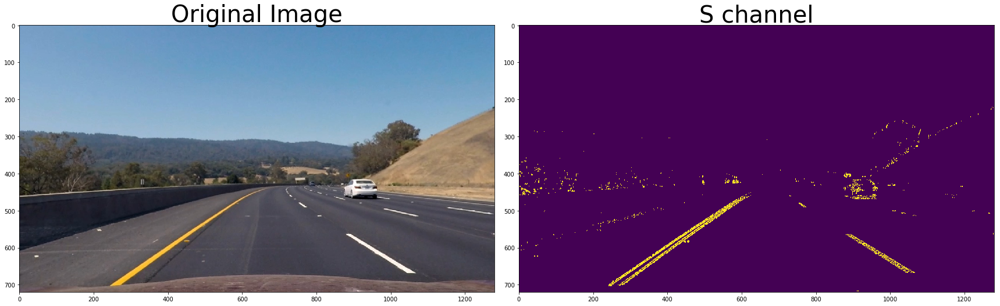

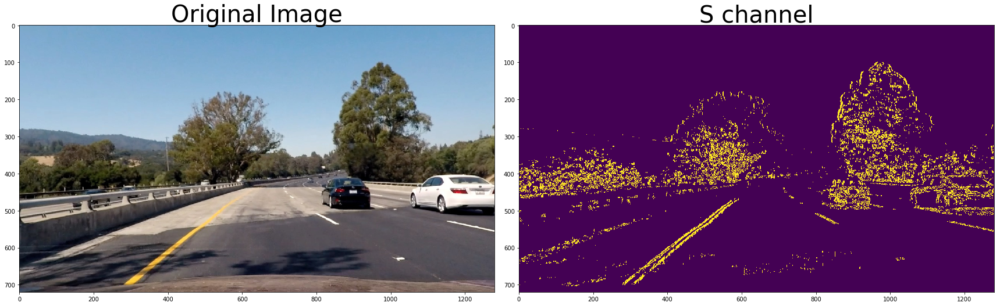

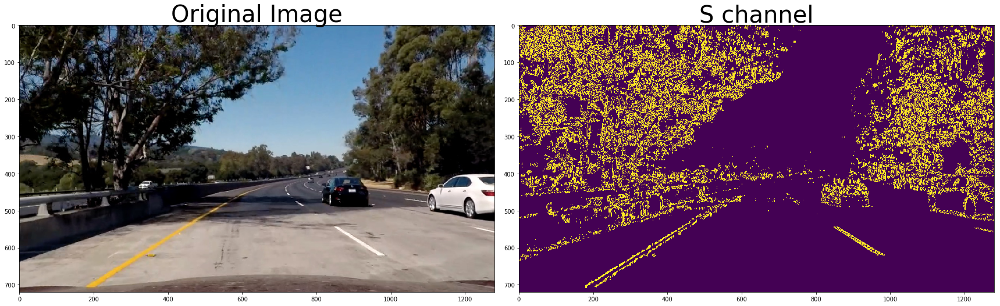

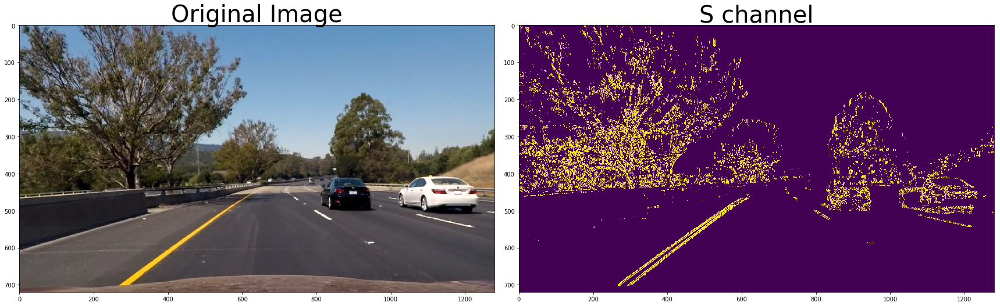

In [6]:
for test_image in test_images:
    S_image = S_threshold(test_image, thresh = (20,100))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(S_image)
    ax2.set_title('S channel', fontsize=40)
    plt.show()

In [7]:
def L_threshold(img, thresh = (20,100)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    L = hls[:,:,2]
    sobelx = cv2.Sobel(L, cv2.CV_64F, 1, 0)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sxbinary

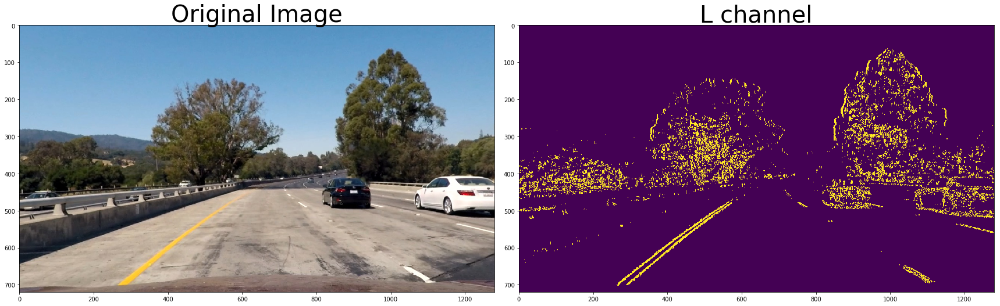

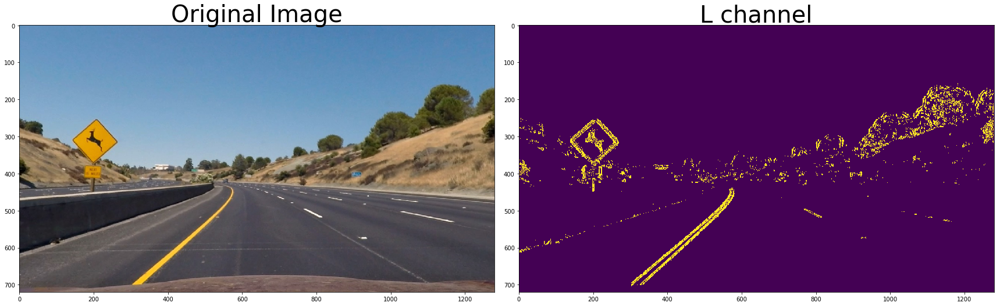

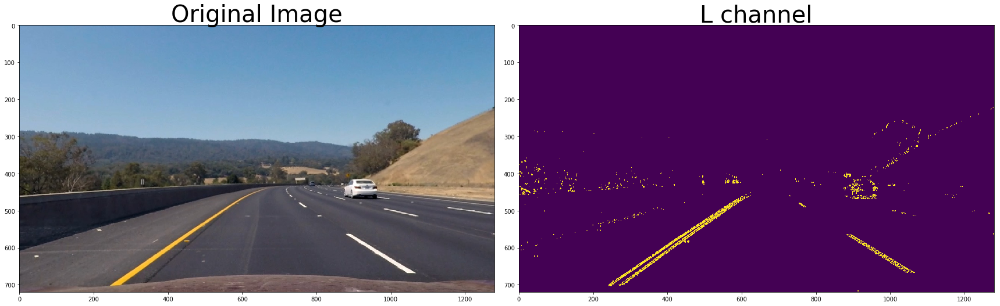

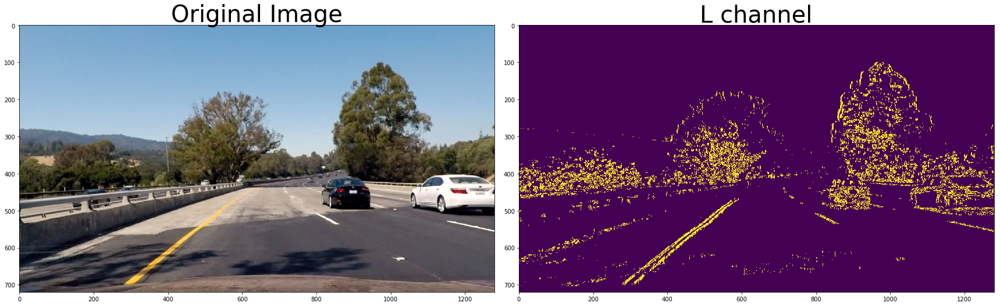

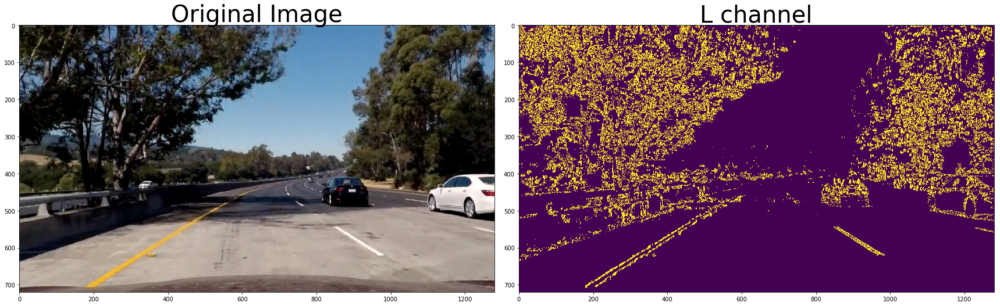

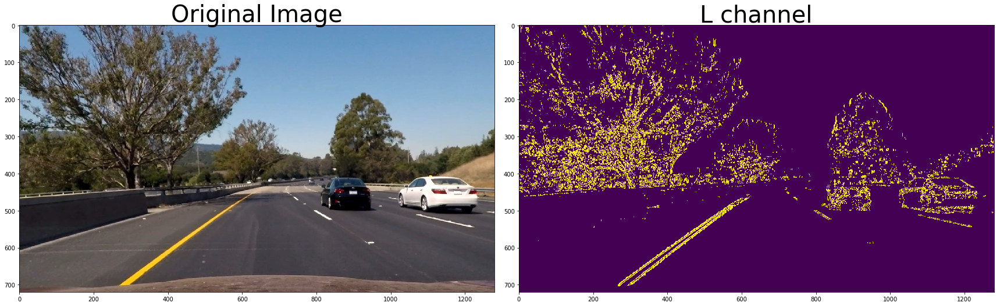

In [8]:
for test_image in test_images:
    L_image = L_threshold(test_image, thresh = (20,100))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(L_image)
    ax2.set_title('L channel', fontsize=40)
    plt.show()

In [9]:
def H_threshold(img, thresh = (170,225)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    H = hls[:,:,0]
    sobelx = cv2.Sobel(H, cv2.CV_64F, 1, 0)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sxbinary

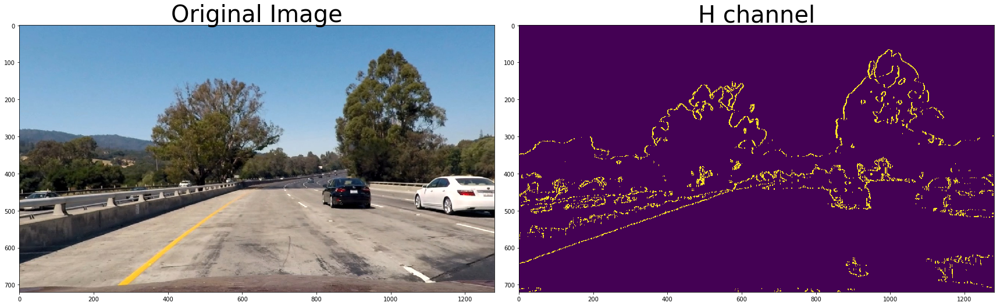

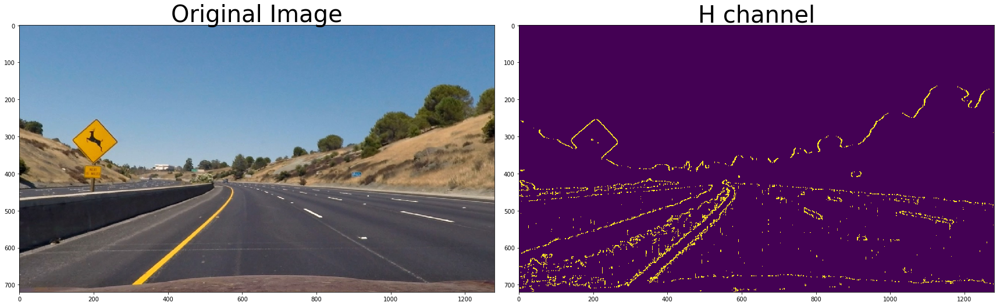

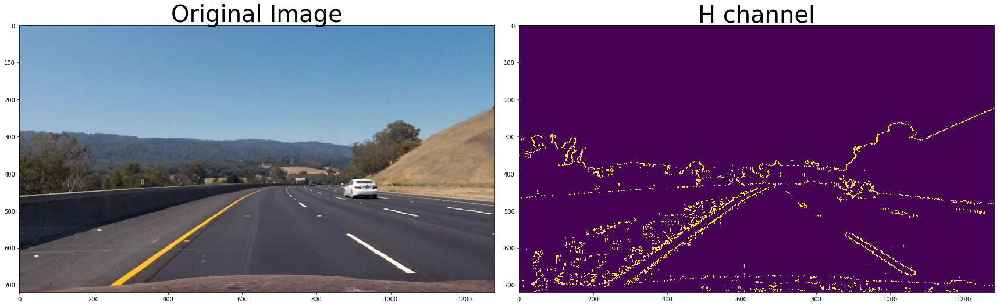

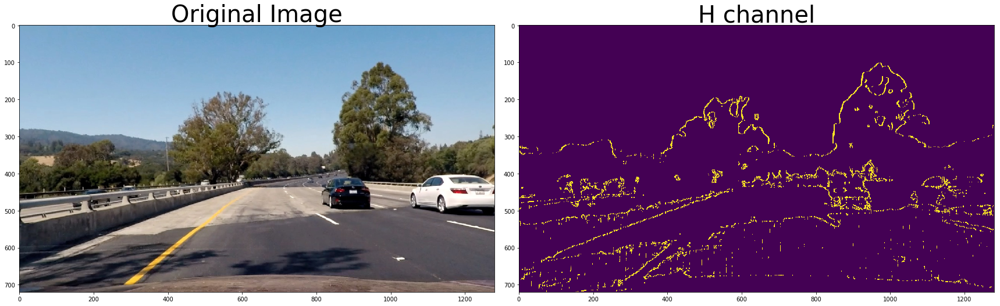

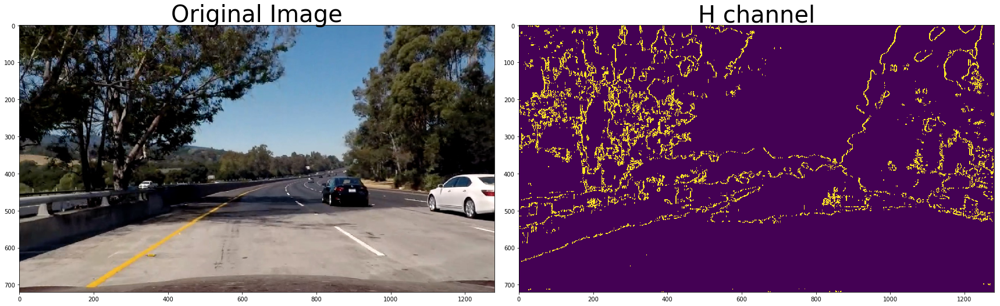

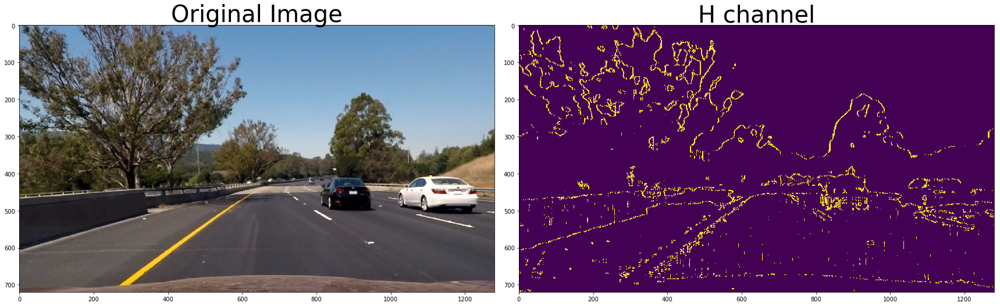

In [10]:
for test_image in test_images:
    H_image = H_threshold(test_image, thresh = (20, 225))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(H_image)
    ax2.set_title('H channel', fontsize=40)
    plt.show()

In [11]:
# RGB threshold

def RGB_threshold(img, thresh = (20, 100)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    RGB_output = np.zeros_like(scaled_sobel)
    RGB_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return RGB_output

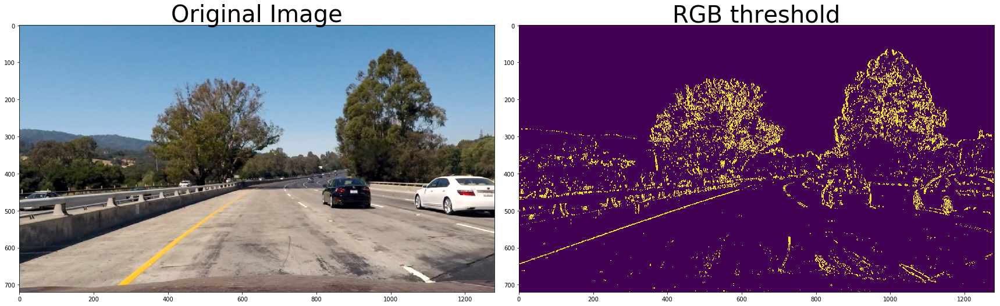

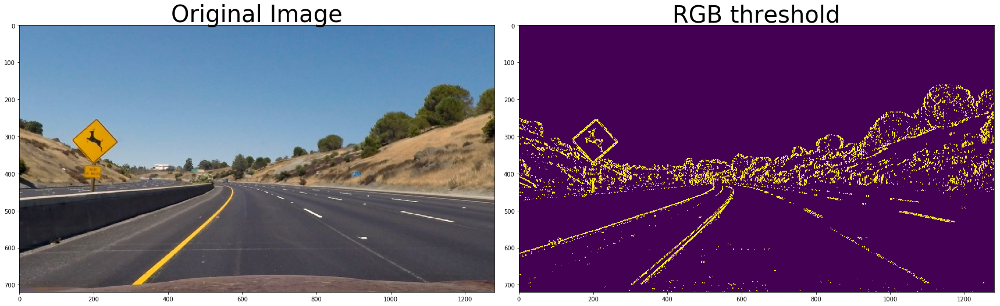

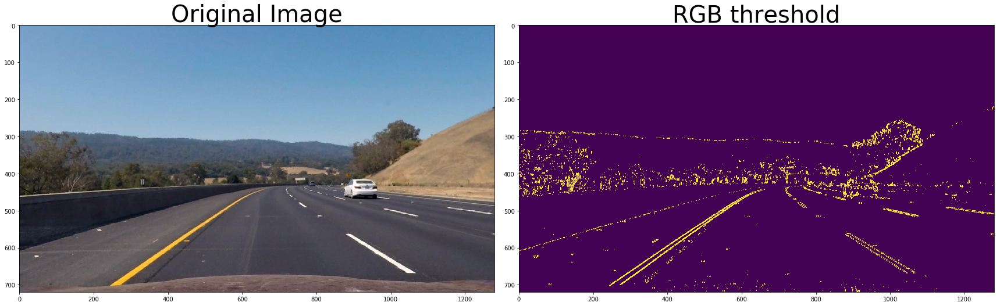

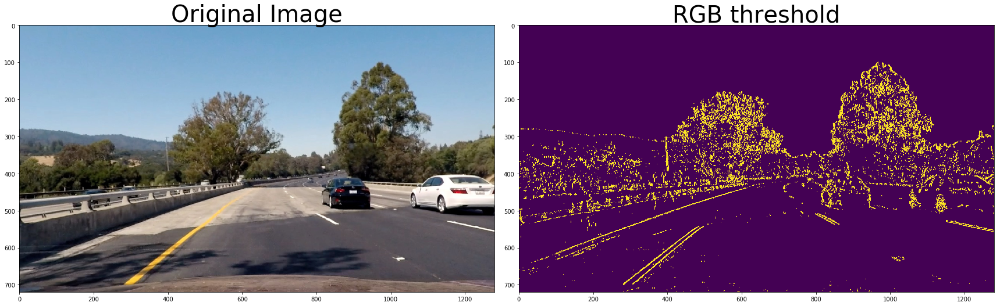

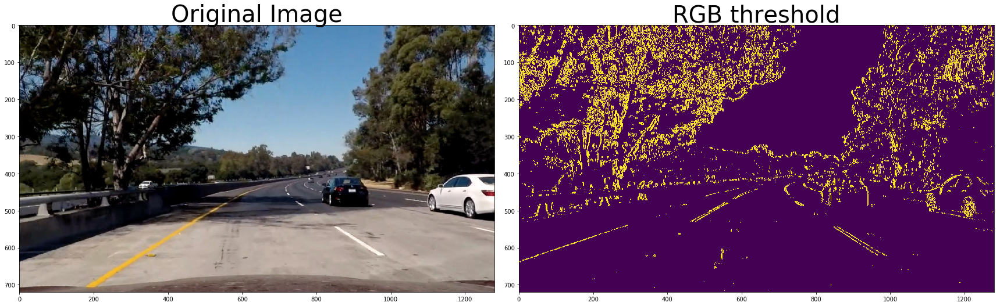

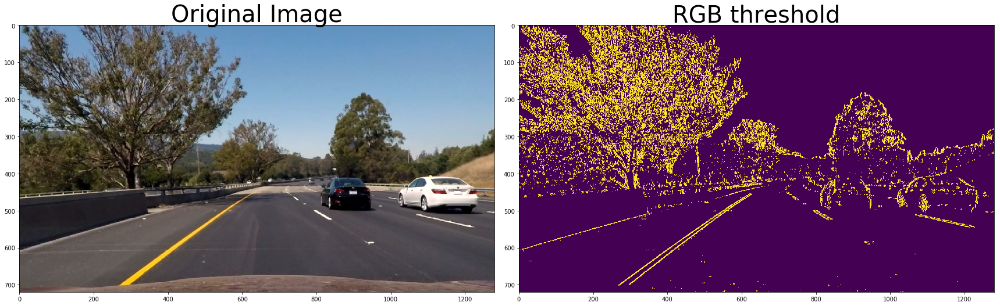

In [12]:
# RGB threshold test

for test_image in test_images:
    RGB_image = RGB_threshold(test_image, thresh = (20,100))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(RGB_image)
    ax2.set_title('RGB threshold', fontsize=40)
    plt.show()

In [13]:
def R_threshold(img, thresh = (20, 100)):
    R = img[:,:,0]
    abs_sobel = np.absolute(cv2.Sobel(R, cv2.CV_64F, 1, 0))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    RGB_output = np.zeros_like(scaled_sobel)
    RGB_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return RGB_output

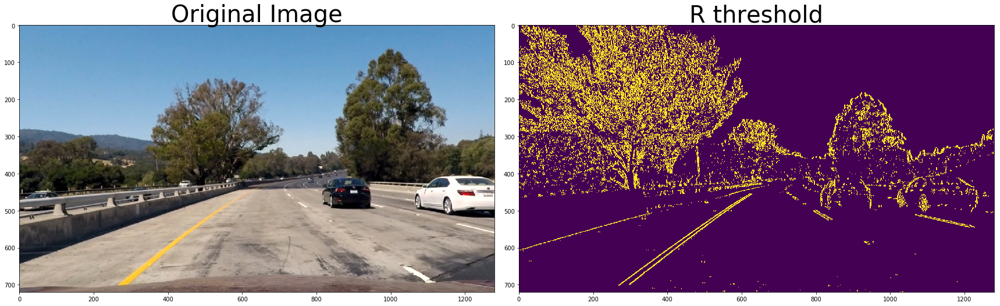

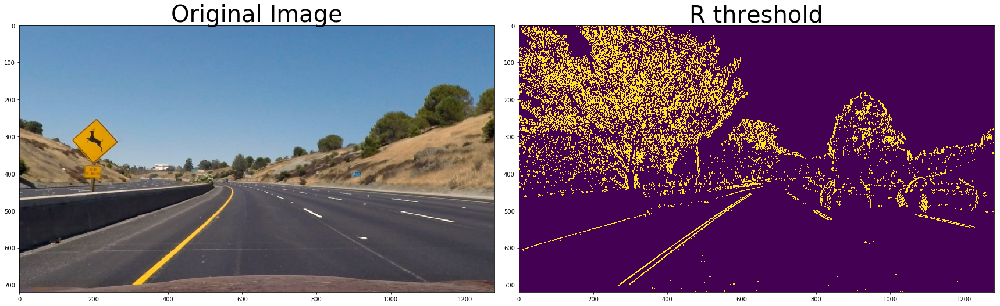

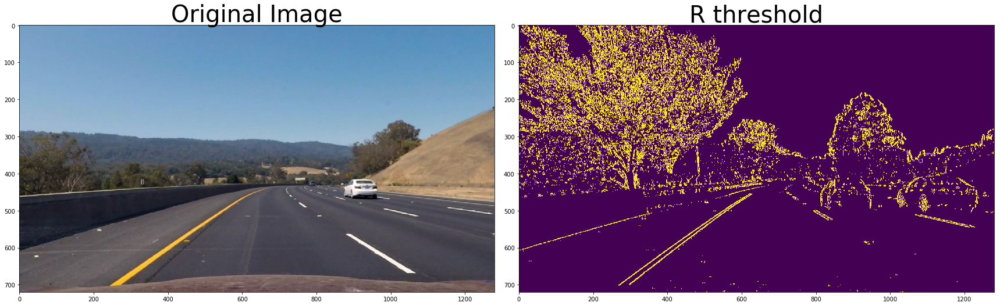

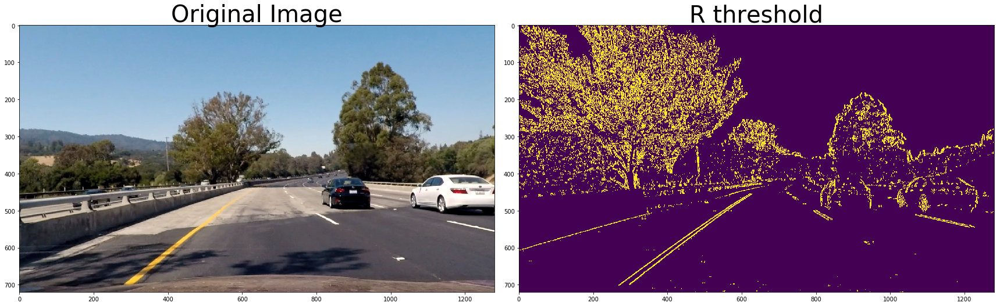

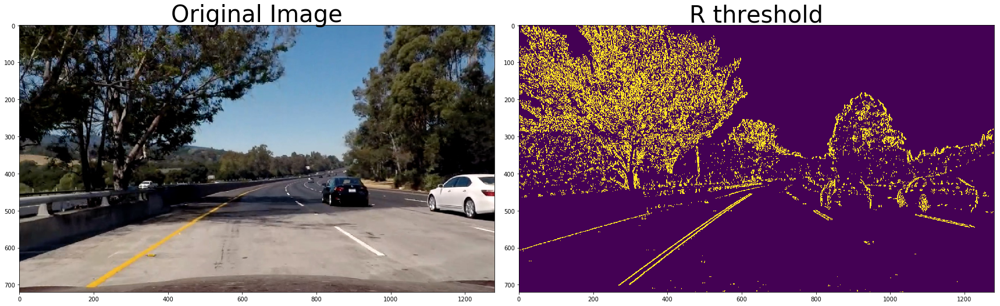

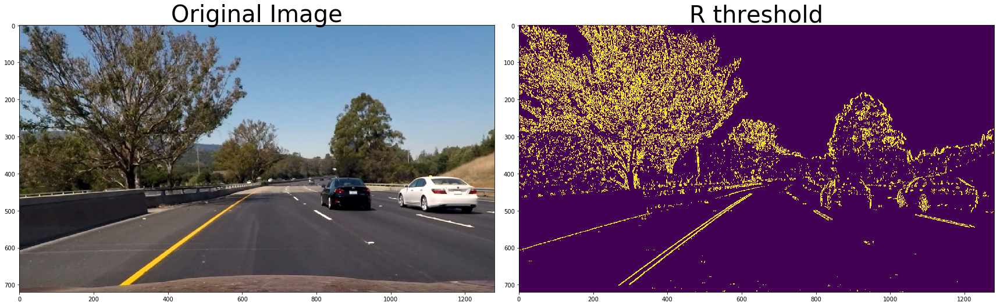

In [14]:
for test_image in test_images:
    R_image = R_threshold(test_image, thresh = (20,100))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(RGB_image)
    ax2.set_title('R threshold', fontsize=40)
    plt.show()

In [15]:
def mag_threshold(img, sobel_kernel=3, thresh=(60, 100)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    return binary_output


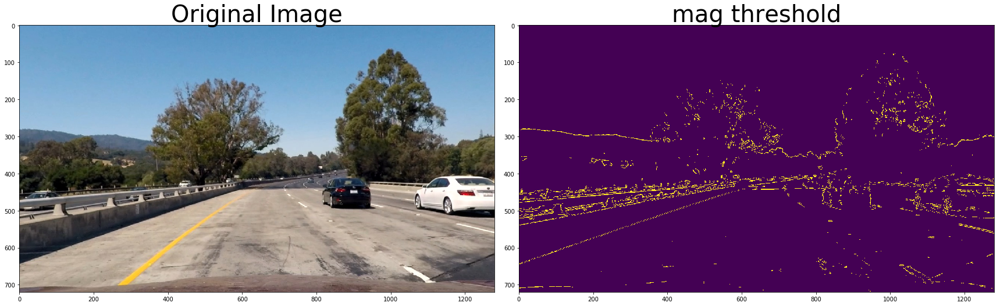

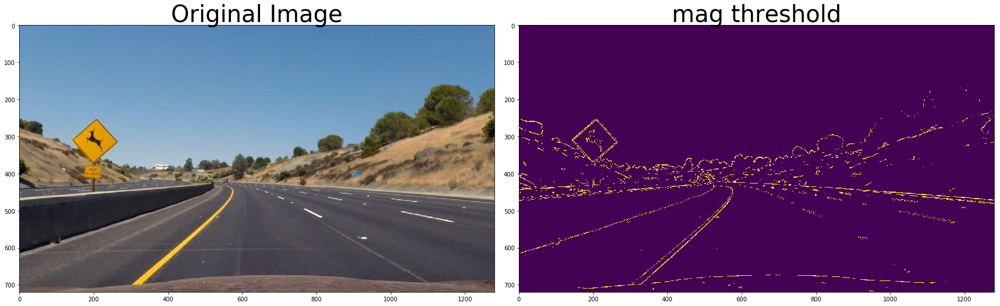

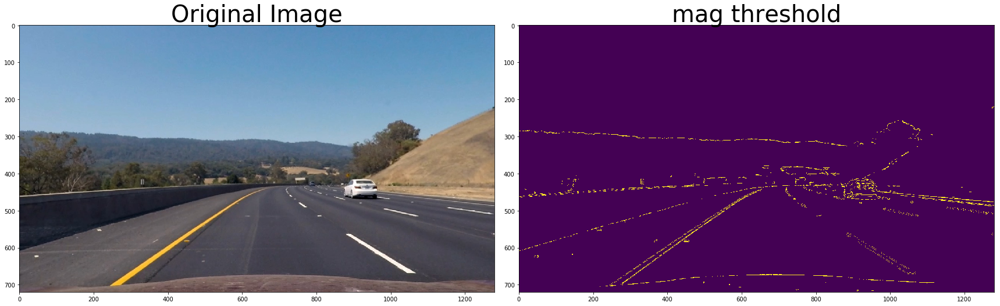

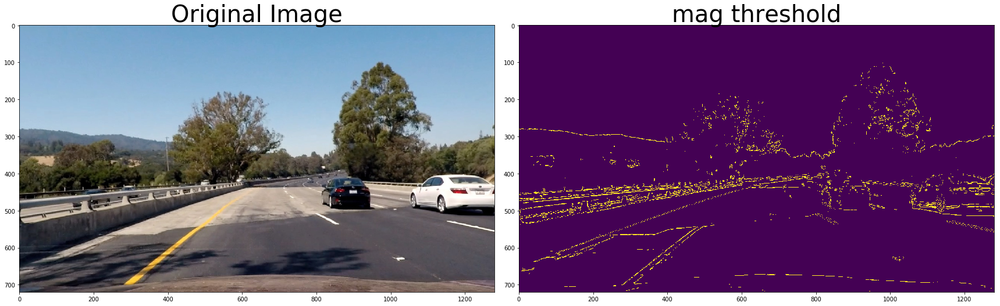

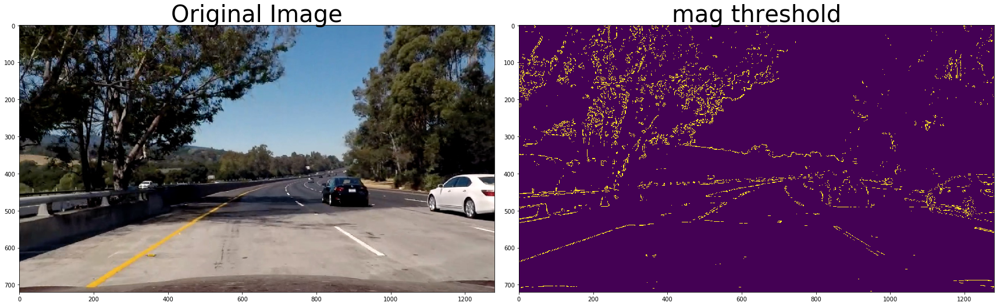

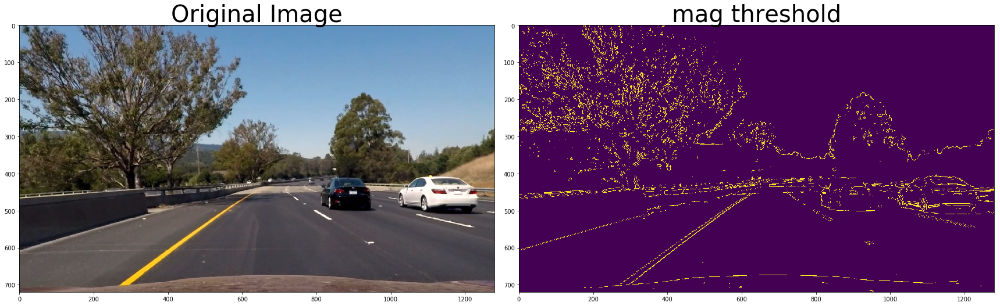

In [16]:
for test_image in test_images:
    mag_image = mag_threshold(test_image, sobel_kernel = 3, thresh = (60,100))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(mag_image)
    ax2.set_title('mag threshold', fontsize=40)
    plt.show()


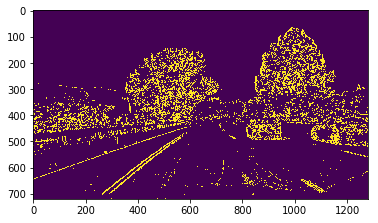

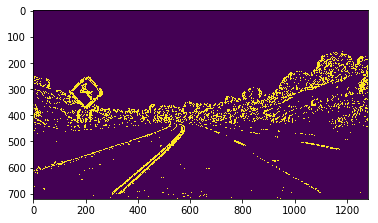

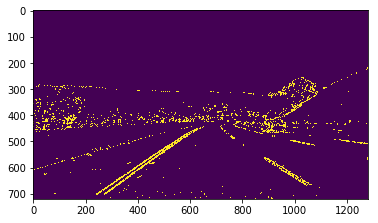

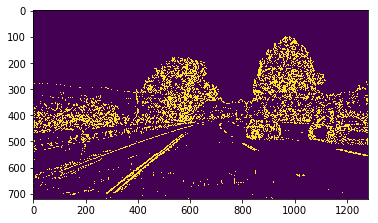

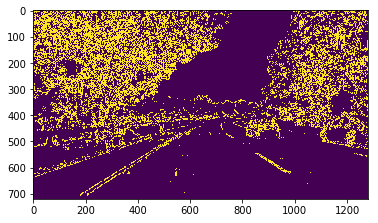

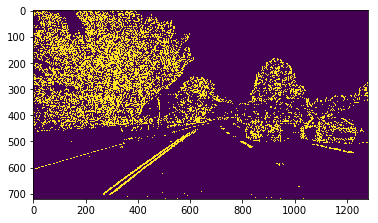

In [17]:
# Combine the threshold images
# Here I just combine R, L and S channel because they perform the best

def combine_threshold(img):
    S_binary = S_threshold(img)
    RGB_binary = RGB_threshold(img)
    mag_binary = mag_threshold(img)
    R_binary = R_threshold(img)
    L_binary = L_threshold(img)
    
    combined = np.zeros_like(S_binary)
    combined[(L_binary == 1) | (S_binary == 1) | (R_binary == 1)] = 1
    return combined

for test_image in test_images:
    combine_binary = combine_threshold(test_image)
    plt.imshow(combine_binary)
    plt.show()

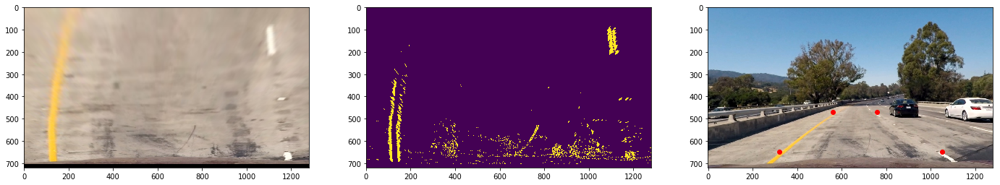

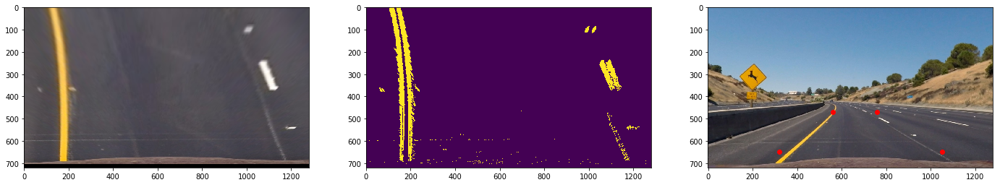

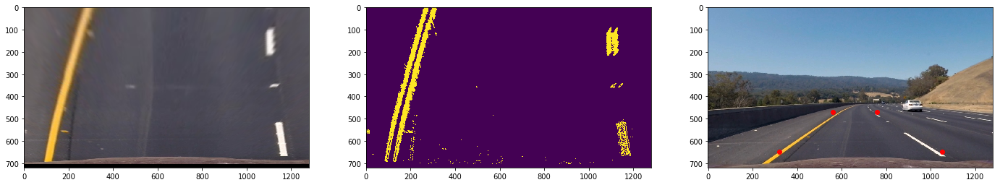

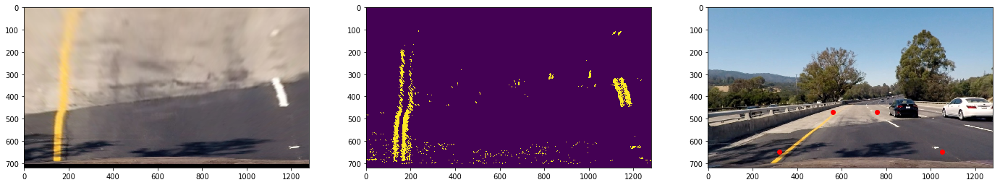

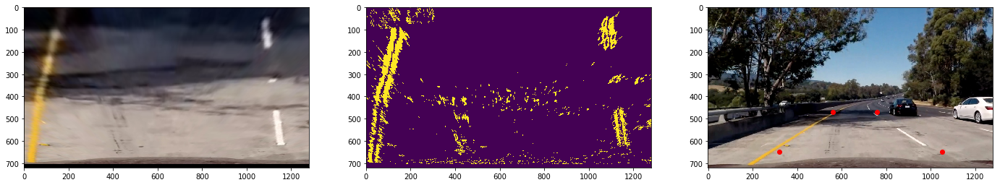

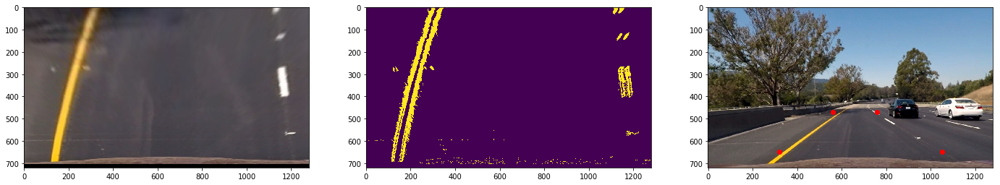

In [18]:
### perspective transform

def perspective_transform(img):

    src = np.float32([[320, 650],
                      [1050, 650], 
                      [760, 470],
                      [560, 470]])
    dst = np.float32([[100, 650], 
                      [1200, 650], 
                      [1200, 0],
                      [100, 0]])
    
    img_size = (img.shape[1], img.shape[0])

    M = cv2.getPerspectiveTransform(src,dst)
    warp = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warp, M

binary_warped_thresholds = []

for test_image in test_images:
    binary_warped, M = perspective_transform(test_image)
    binary_warped_threshold = combine_threshold(binary_warped)
    binary_warped_thresholds.append(binary_warped_threshold)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    ax1.imshow(binary_warped)
    ax2.imshow(binary_warped_threshold)
    ax3.imshow(test_image)
    ax3.plot([320,1050,760,560], [650, 650, 470, 470], 'ro')
    plt.show()

In [19]:
# finding and fitting lanes
def find_lanes(binary_warped_threshold):
    histogram = np.sum(binary_warped_threshold[binary_warped_threshold.shape[0]/2:,:], axis=0)
    out_img = np.dstack((binary_warped_threshold, binary_warped_threshold, binary_warped_threshold))*255

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped_threshold.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped_threshold.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped_threshold.shape[0] - (window+1)*window_height
        win_y_high = binary_warped_threshold.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ploty = np.linspace(0, binary_warped_threshold.shape[0]-1, binary_warped_threshold.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]


    nonzero = binary_warped_threshold.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped_threshold.shape[0]-1, binary_warped_threshold.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped_threshold, binary_warped_threshold, binary_warped_threshold))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

#     # Draw the lane onto the warped blank image
#     cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
#     cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
#     result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
#     plt.imshow(result)
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
#     plt.xlim(0, 1280)
#     plt.ylim(720, 0)
#     plt.show()
    
    return ploty, left_fitx, right_fitx, left_fit, right_fit

ploty, left_fitx, right_fitx, left_fit, right_fit = find_lanes(binary_warped_threshold)

C:\Users\PRO\Miniconda3\envs\carnd-term1\lib\site-packages\ipykernel\__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


In [20]:
def lanes_fit(left_fit, right_fit):
    leftx = np.array([y*left_fit[1] + (y**2)*left_fit[0] + left_fit[2] + np.random.randint(-50, high=51) 
                                  for y in ploty])
    rightx = np.array([y*right_fit[1] + (y**2)*right_fit[0] + right_fit[2] + np.random.randint(-50, high=51) 
                                    for y in ploty])

    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


#     # Fit a second order polynomial to pixel positions in each fake lane line
#     left_fit = np.polyfit(ploty, leftx, 2)
#     left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#     right_fit = np.polyfit(ploty, rightx, 2)
#     right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

#     # Plot up the fake data
#     mark_size = 3
#     plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
#     plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
#     plt.xlim(0, 1280)
#     plt.ylim(0, 720)
#     plt.plot(left_fitx, ploty, color='green', linewidth=3)
#     plt.plot(right_fitx, ploty, color='green', linewidth=3)
#     plt.gca().invert_yaxis() # to visualize as we do the images
#     plt.show()
    
    return leftx, rightx

In [21]:
# Compute the curvature of the lane
def curvature(left_fit, right_fit, leftx, rightx):
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    a = left_curverad
    b = right_curverad
    c = a+b
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    d = left_curverad + right_curverad
    k = d/c
    return left_curverad, right_curverad, k

In [22]:
# draw the area surrounded by lanes
def draw(img, left_fitx, right_fitx, ploty):
    warped = combine_threshold(img)
    src = np.float32([[320, 650],
                      [1050, 650], 
                      [760, 470],
                      [560, 470]])
    dst = np.float32([[100, 650], 
                      [1200, 650], 
                      [1200, 0],
                      [100, 0]])
    Minv = cv2.getPerspectiveTransform(dst, src)
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
#     plt.imshow(result)
#     plt.show()
    
    return result

In [23]:
def put_text(img, left_curverad, right_curverad, leftx, rightx, k):
    avg = (left_curverad + right_curverad)/2
    font = cv2.FONT_HERSHEY_SIMPLEX
    off = (680-(rightx[-1]-leftx[-1])/2)*k/100
    cv2.putText(img, 'curve radius = {:.0f}m'.format(avg),(660,100), font, 1.5,(0, 0, 0),2)
    cv2.putText(img, 'away from center = {:.2f}m'.format(off),(600,170), font, 1.5,(0, 0, 0),2)
    
    return img


C:\Users\PRO\Miniconda3\envs\carnd-term1\lib\site-packages\ipykernel\__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


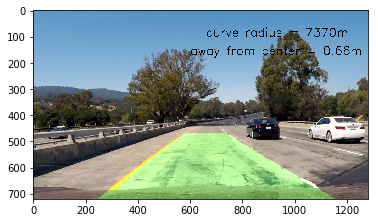

In [24]:
# Process image

def process_image(img):
    undistorted_image = undistort(img, mtx, dist)
    threshold = combine_threshold(undistorted_image)
    warp, M = perspective_transform(threshold)
    ploty, left_fitx, right_fitx, left_fit, right_fit = find_lanes(warp)
    leftx, rightx = lanes_fit(left_fit, right_fit)
    left_curverad, right_curverad, k = curvature(left_fit, right_fit, leftx, rightx)
    img = put_text(img, left_curverad, right_curverad, leftx, rightx, k)
    result = draw(img, left_fitx, right_fitx, ploty)
    
    return result
    
a = process_image(mpimg.imread('C://self-driving//CarND-Advanced-Lane-Lines-master//test_images//test' + str(1) + '.jpg'))
plt.imshow(a)
plt.show()

C:\Users\PRO\Miniconda3\envs\carnd-term1\lib\site-packages\ipykernel\__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


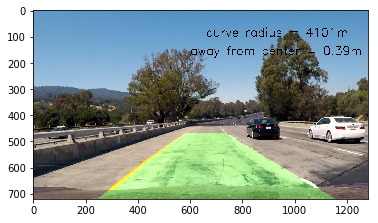

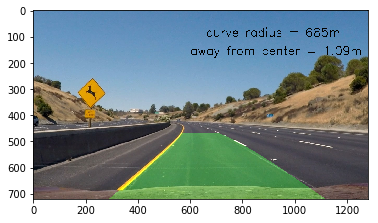

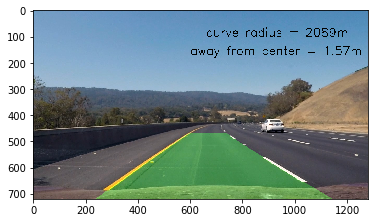

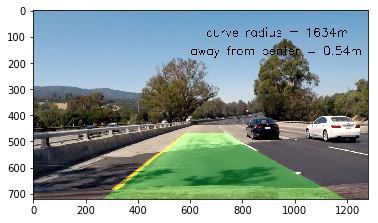

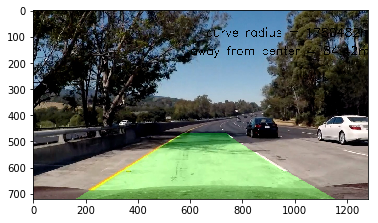

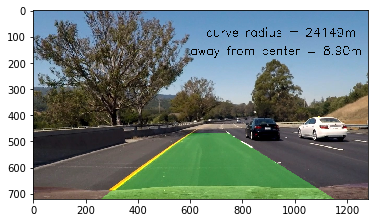

In [25]:
# Result for test images
for i in range(1,7):
    final_picture = process_image(mpimg.imread('C://self-driving//CarND-Advanced-Lane-Lines-master//test_images//test' + str(i) + '.jpg'))
    plt.imshow(final_picture)
    plt.show()

In [26]:
# Make a video
from moviepy.editor import VideoFileClip

white_output = 'advanced_lane_finding.mp4'
clip1 = VideoFileClip('C://self-driving//CarND-Advanced-Lane-Lines-master//project_video.mp4')
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video advanced_lane_finding.mp4
[MoviePy] Writing video advanced_lane_finding.mp4


100%|████████████████████████████████████████████▉| 1260/1261 [20:22<00:00,  1.01it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: advanced_lane_finding.mp4 

